In [1]:
# Importing all the Necessary Libraries for my Resetnet 50 model build for Plant disease classification

# Standard Libraries
import os
import random
import itertools
import warnings

# The Bellow are Numerical and Data Manipulation Libraries
import numpy as np
import pandas as pd

#  Beleow are Visualization Libraries
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns

# Libraries for PyTorch for Deep Learning
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import transforms, datasets, models

# TensorFlow and Keras
import tensorflow as tf

# Machine Learning Utilities
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

# Image Processing
from PIL import Image
import cv2

# Ignore Warnings
warnings.filterwarnings("ignore")


In [2]:
## Conection with Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
## Load and extract the dataset
input_path = "/content/drive/MyDrive/dataset.zip"

local_zip = input_path
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/content/drive/MyDrive/')
zip_ref.close()

In [3]:
My_Drive = "/content/drive/MyDrive/"

Testing_Images = My_Drive+ "/TestingRandomeImages"

In [ ]:
# lets us now Visualise the Class Distribution of Corn Dataset

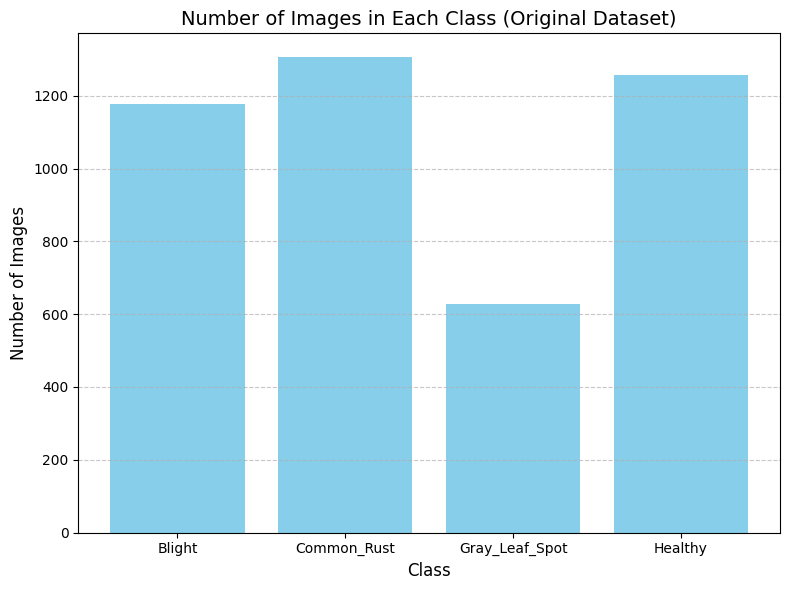

In [4]:
# data_path = "dataset"
data_path = "/content/drive/MyDrive/dataset"

# Load the dataset
original_dataset = datasets.ImageFolder(root=data_path)

# Get class names and counts
class_names = original_dataset.classes
class_counts = pd.Series(original_dataset.targets).value_counts().sort_index()

# Plot a bar graph for the number of images in each class
plt.figure(figsize=(8, 6))
plt.bar(class_names, class_counts, color='skyblue')
plt.xlabel('Class', fontsize=12)
plt.ylabel('Number of Images', fontsize=12)
plt.title('Number of Images in Each Class (Original Dataset)', fontsize=14)
plt.xticks(rotation=0, fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


## Splitting the Data Into Train, Validation and Test Sets

I divided the data into Train, Validation, and Test sets by 70%, 20%, and 10%, respectively, using the splitfolders package.

In [7]:
!pip install split-folders



In [8]:
import splitfolders
splitfolders.ratio("/content/drive/MyDrive/dataset",output="/content/drive/MyDrive/splitted_data4",
                   seed=42,ratio=(.7, .2, .1),group_prefix=None, move=False)

Copying files: 4368 files [02:39, 27.35 files/s]


Resizing and Normalizing methods are applied to all of the datasets but data augmentation techniques are only applied to Train set in order to richen the data so that the model possibly will yield more accurate results.

In [9]:
# Constants
IMAGE_SIZE = 224
BATCH_SIZE = 32
NUM_CLASSES = 4

LEARNING_RATE = 0.001


# Device Setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


## Dataset Loading and Preprocessing

In [10]:
# Transformations
train_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


In [11]:

# Load Dataset
# data_dir = "splitted_data/"
data_dir = "/content/drive/MyDrive/splitted_data"
SavedModels_resnet50 = "/content/drive/MyDrive/SavedModels/RESNET50_Ver4"

train_dataset = datasets.ImageFolder(os.path.join(data_dir, "train"), transform=train_transform)
val_dataset = datasets.ImageFolder(os.path.join(data_dir, "val"), transform=val_transform)
test_dataset = datasets.ImageFolder(os.path.join(data_dir, "test"), transform=val_transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4)



In [12]:
# print("Dataset Labels:\n", train.class_to_idx, "\n")
# Distribution of our Training, Validation, and Testing Sets in each classes
sizes=[]
for name, dataset in zip(["TRAIN", "VALIDATION", "TEST"], [train_dataset, val_dataset, test_dataset]):
    images_per_class = pd.Series(dataset.targets).value_counts()
    total_images = len(dataset.targets)
    sizes.append(total_images)
    print(f"Images per Class in {name}:")
    print(images_per_class, "\n")
    print(sizes)

Images per Class in TRAIN:
1    914
3    880
0    823
2    439
Name: count, dtype: int64 

[3056]
Images per Class in VALIDATION:
1    261
3    251
0    235
2    125
Name: count, dtype: int64 

[3056, 872]
Images per Class in TEST:
1    131
3    127
0    118
2     64
Name: count, dtype: int64 

[3056, 872, 440]


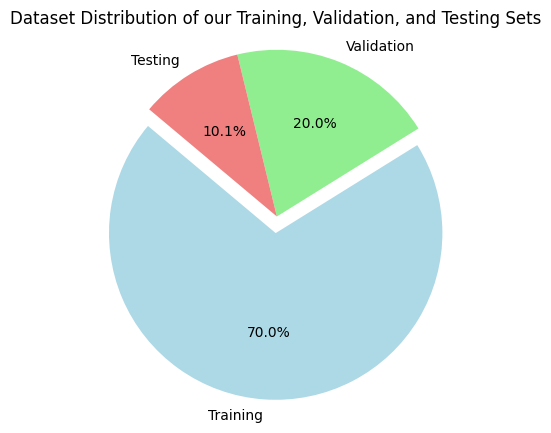

In [13]:
# Data for the pie chart for Distribution of our Training, Validation, and Testing Sets
labels = ['Training', 'Validation', 'Testing']

colors = ['lightblue', 'lightgreen', 'lightcoral']
explode = (0.1, 0, 0)  # Highlight the training set

# Plot the pie chart
plt.figure(figsize=(5, 5))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
plt.title('Dataset Distribution of our Training, Validation, and Testing Sets')
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular
plt.show()


Lets Visualise the random images from different folders in our  dataset

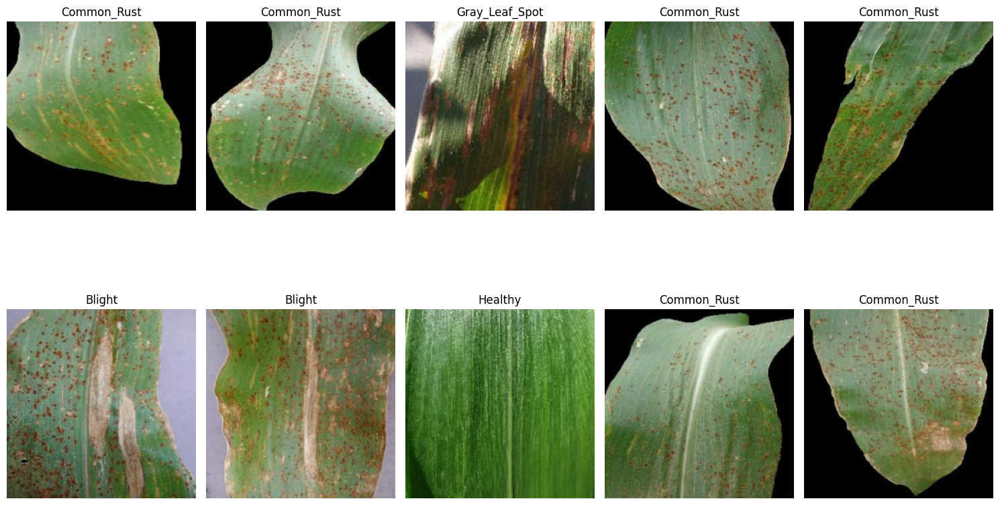

In [14]:
# Lets Visualise the random images from different folders in our  dataset
import matplotlib.pyplot as plt
import random

# Function to visualize random images from a dataset
def plot_random_images(dataset, num_images=15, rows=3, cols=5):
    # Get class labels
    labels_for_viz = {v: k for k, v in dataset.class_to_idx.items()}

    # Create a figure
    fig, ax = plt.subplots(rows, cols, figsize=(15, 10))
    ax = ax.flatten()

    # Plot random samples
    for i in range(num_images):
        sample_idx = random.randint(0, len(dataset) - 1)  # Random index
        img, label = dataset[sample_idx]  # Get image and label
        img = img.permute(1, 2, 0).numpy()  # Convert from Tensor to NumPy
        img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Unnormalize
        img = img.clip(0, 1)  # Clip to valid range

        ax[i].imshow(img)
        ax[i].title.set_text(labels_for_viz[label])  # Get label name
        ax[i].axis('off')  # Hide axes

    plt.tight_layout()
    plt.show()

# Call the function with train_dataset
# plot_random_images(train_dataset, num_images=15, rows=3, cols=5)
plot_random_images(val_dataset, num_images=10, rows=2, cols=5)

# Let us now visualise augmented images

data augmentation methods are applied to Train set,
it can be seen that images are blurred, horizontally and vertically flipped compared to the unaugmented images.

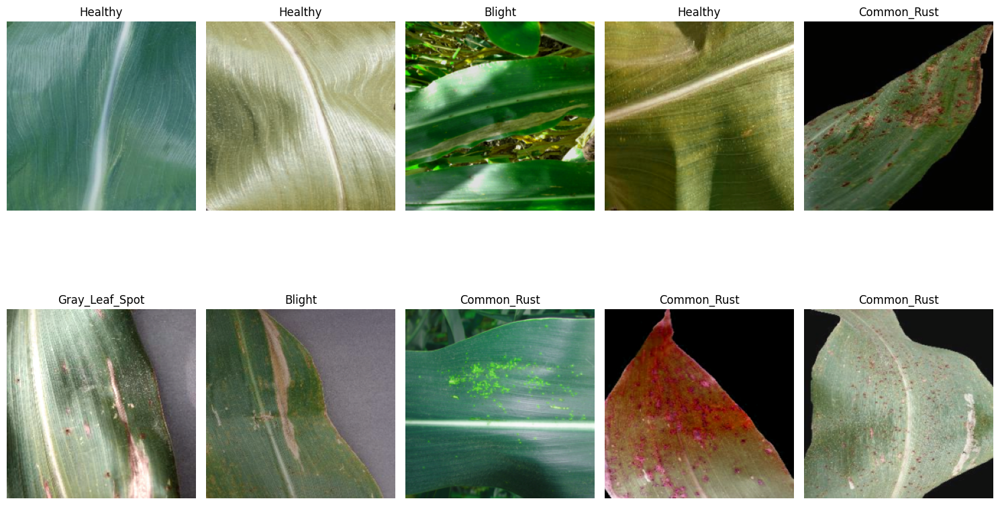

In [15]:
# Function to visualize augmented images
def plot_augmented_images(dataset, num_images=15, rows=3, cols=5):

    # Get class labels
    labels_for_viz = {v: k for k, v in dataset.class_to_idx.items()}

    # Create a figure
    fig, ax = plt.subplots(rows, cols, figsize=(15, 10))
    ax = ax.flatten()

    # Plot random augmented samples
    for i in range(num_images):
        sample_idx = random.randint(0, len(dataset) - 1)  # Random index
        img, label = dataset[sample_idx]  # Get image and label
        img = img.permute(1, 2, 0).numpy()  # Convert from Tensor to NumPy
        img = img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]  # Unnormalize
        img = img.clip(0, 1)  # Clip to valid range

        ax[i].imshow(img)
        ax[i].title.set_text(labels_for_viz[label])  # Get label name
        ax[i].axis('off')  # Hide axes

    plt.tight_layout()
    plt.show()

# Call the function with train_dataset
plot_augmented_images(train_dataset, num_images=10, rows=2, cols=5)


# Resnet-50 Model creation and training

In [16]:
# Define the model
model = models.resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)  # Modify output layer
model = model.to(device)

# Loss and Optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 165MB/s]


In [17]:
history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}  # to save the history of the learning curves
EPOCHS = 25

In [18]:
# Training Function
def train_model(model, train_loader, val_loader, criterion, optimizer, epochs):

    for epoch in range(epochs):
    # Here i am setting the module to the Training mode
        model.train()
        train_loss = 0
        correct = 0
        total = 0
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
    # Here below we will Calculate the number of correct predictions
            _, predicted = outputs.max(1)  # Get class with highest probability
            total += labels.size(0)  # Total number of labels
            correct += predicted.eq(labels).sum().item()   # Count correct predictions

        train_acc = 100. * correct / total
        history['train_loss'].append(train_loss / len(train_loader))
        history['train_acc'].append(train_acc)

     # Below starts the Validation Phase
        model.eval()
        val_loss = 0
        correct = 0
        total = 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = outputs.max(1)
                total += labels.size(0)
                correct += predicted.eq(labels).sum().item()

        val_acc = 100. * correct / total
        history['val_loss'].append(val_loss / len(val_loader))
        history['val_acc'].append(val_acc)

        print(f"Epoch [{epoch+1}/{epochs}], Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%")


In [19]:

train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)

Epoch [1/25], Train Acc: 81.84%, Val Acc: 81.54%
Epoch [2/25], Train Acc: 87.76%, Val Acc: 89.91%
Epoch [3/25], Train Acc: 88.35%, Val Acc: 91.17%
Epoch [4/25], Train Acc: 89.73%, Val Acc: 91.06%
Epoch [5/25], Train Acc: 90.84%, Val Acc: 91.74%
Epoch [6/25], Train Acc: 91.79%, Val Acc: 91.28%
Epoch [7/25], Train Acc: 91.88%, Val Acc: 92.78%
Epoch [8/25], Train Acc: 91.72%, Val Acc: 94.50%
Epoch [9/25], Train Acc: 92.70%, Val Acc: 93.58%
Epoch [10/25], Train Acc: 92.77%, Val Acc: 89.79%
Epoch [11/25], Train Acc: 93.29%, Val Acc: 92.66%
Epoch [12/25], Train Acc: 93.55%, Val Acc: 93.69%
Epoch [13/25], Train Acc: 94.31%, Val Acc: 87.27%
Epoch [14/25], Train Acc: 94.27%, Val Acc: 90.14%
Epoch [15/25], Train Acc: 93.39%, Val Acc: 93.12%
Epoch [16/25], Train Acc: 93.59%, Val Acc: 94.15%
Epoch [17/25], Train Acc: 94.11%, Val Acc: 84.63%
Epoch [18/25], Train Acc: 93.91%, Val Acc: 91.74%
Epoch [19/25], Train Acc: 94.90%, Val Acc: 92.89%
Epoch [20/25], Train Acc: 94.04%, Val Acc: 91.86%
Epoch [21

In [20]:
print(history)

{'train_loss': [0.46412625319013995, 0.31324924156069756, 0.28308362800938386, 0.24829567992128432, 0.2337380212265998, 0.20263618067838252, 0.19803080636969148, 0.19336646896166107, 0.1871479575832685, 0.19012236575751254, 0.17411281686509028, 0.16851984763828418, 0.15143697567206496, 0.1517734044076254, 0.1648074098241826, 0.1649115476757288, 0.16045165107546686, 0.15493543744863322, 0.1278672492141292, 0.1448454688070342, 0.1502102514884124, 0.13797737806938434, 0.14673941953030104, 0.12918995108339004, 0.1117084888392128], 'train_acc': [81.83900523560209, 87.76178010471205, 88.35078534031413, 89.72513089005236, 90.83769633507853, 91.78664921465969, 91.8848167539267, 91.72120418848168, 92.70287958115183, 92.76832460732984, 93.29188481675392, 93.55366492146597, 94.30628272251309, 94.27356020942409, 93.39005235602095, 93.58638743455498, 94.10994764397905, 93.91361256544502, 94.89528795811518, 94.04450261780104, 94.27356020942409, 94.76439790575917, 94.79712041884817, 94.79712041884817

In [21]:

import json

# Save history to a JSON file
def save_history_to_json(history, filename):
    with open(filename, 'w') as f:
        json.dump(history, f)
    print(f"History saved to {filename}")

# Call the function
save_history_to_json(history, SavedModels_resnet50+"/Resnet50_training_historyV3.json")


History saved to /content/drive/MyDrive/SavedModels/RESNET50_Ver4/Resnet50_training_historyV3.json


# Saving the model

In [22]:
# Saving the model for later usw if in case!! as colab runtime is limited with GPU
torch.save(model.state_dict(), SavedModels_resnet50+"/resnet50_corn_disease_PRECOPYV3.pth")

Uncomment Below if wanna load the model

In [ ]:
# # Loading The Model in my Local version which we trained

# # Define the model architecture
# NUM_CLASSES = 4  # Adjust this to your number of classes
# model = models.resnet50(pretrained=True)
# model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)

# # Load the saved weights, mapping them to the CPU
# # model.load_state_dict(torch.load("SavedModels/resnet50_corn_disease_PRECOPYV2.pth", map_location=torch.device('cpu')))
# model.load_state_dict(torch.load(SavedModels_resnet50+"/resnet50_corn_disease_PRECOPYV2.pth"))
# # Move the model to the CPU
# # device = torch.device("cpu")


# model = model.to(device)

# # Set the model to evaluation mode
# model.eval()

# print("Model loaded successfully and is ready for evaluation.")



# Evaluation of the Model

In [23]:
# This function evaluates the model's performance on a test dataset by calculating the average loss and accuracy.
# Evaluate Function
def evaluate_model(model, test_loader, criterion):
    model.eval()
    test_loss = 0
    correct = 0
    total = 0
    # the below code processes the test data in batches, computes predictions and compares them with the true labels.
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
    test_acc = 100. * correct / total
    test_loss /= len(test_loader)

    # Return test loss and accuracy
    return test_loss, test_acc


# Accuracy on test Set

In [24]:
# Evaluate the model
test_loss, test_acc = evaluate_model(model, test_loader, criterion)
print(f'\nTest Accuracy: {test_acc:.2f}%  Test Loss: {test_loss:.4f}')
#  We got the accuracy of 94.77%


Test Accuracy: 96.36%  Test Loss: 0.1274


## Prediction for test set Images

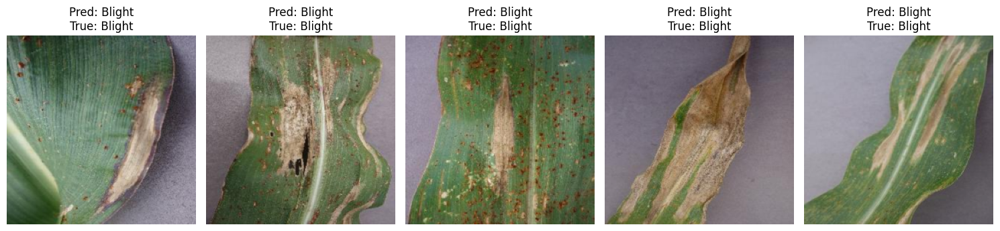

In [25]:

# Visualize predictions
# function displays a visual comparison of model predictions and true labels for a specified number of images from the test dataset.
def visualize_predictions(model, test_loader, num_images=5):
    model.eval()  # Set model to evaluation mode
    images, labels = next(iter(test_loader))  # Fetch a batch of test images
    images, labels = images.to(device), labels.to(device)  # Move data to device

    # Get predictions
    outputs = model(images)
    _, preds = outputs.max(1)

    # Create a single-row plot
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

    for i in range(num_images):
        img = images[i].cpu().permute(1, 2, 0).numpy()  # Convert to H x W x C format
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Unnormalize
        img = np.clip(img, 0, 1)  # Clip pixel values to [0, 1]

        axes[i].imshow(img)
        axes[i].set_title(f"Pred: {test_dataset.classes[preds[i]]}\nTrue: {test_dataset.classes[labels[i]]}")
        axes[i].axis('off')  # Hide axes

    plt.tight_layout()
    plt.show()

# Call the function
visualize_predictions(model, test_loader, num_images=5)


In [ ]:
# Lets Visualize Random Predictions

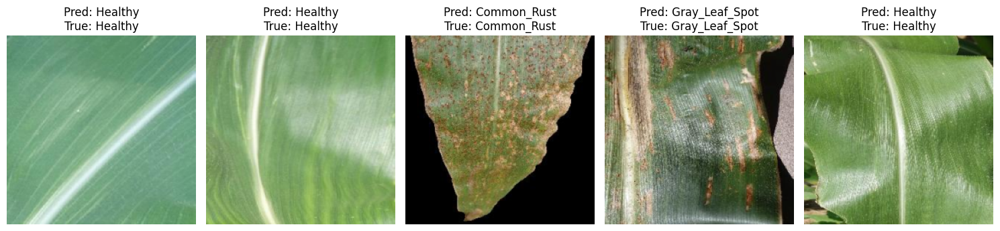

In [26]:
# Visualize predictions from different classes
def visualize_random_predictions(model, test_dataset, num_images=5):
    model.eval()  # Set model to evaluation mode

    # Randomly sample indices from the entire test dataset
    random_indices = random.sample(range(len(test_dataset)), num_images)

    # Create a single-row plot
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

    for i, idx in enumerate(random_indices):
        # Get the image and label
        img, label = test_dataset[idx]

        # Prepare the image for the model
        img_tensor = img.unsqueeze(0).to(device)  # Add batch dimension and move to device
        output = model(img_tensor)
        _, pred = output.max(1)  # Get predicted label

        # Unnormalize the image for display
        img = img.permute(1, 2, 0).numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])  # Unnormalize
        img = np.clip(img, 0, 1)  # Clip pixel values to [0, 1]

        # Plot the image
        axes[i].imshow(img)
        axes[i].set_title(f"Pred: {test_dataset.classes[pred.item()]}\nTrue: {test_dataset.classes[label]}")
        axes[i].axis('off')  # Hide axes

    plt.tight_layout()
    plt.show()

# Call the function with test_dataset
visualize_random_predictions(model, test_dataset, num_images=5)


In [ ]:
# all predictions and true labels from the test dataset:

In [27]:
# Function to compute predictions and true labels for the test dataset
def get_predictions_and_labels(model, test_loader):
    model.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad():
         # Iterate through test dataset
        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)
            # Get model predictions
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
   # Return predictions and labels as arrays
    return np.array(all_preds), np.array(all_labels)

# Get predictions and labels
predicted_labels, true_labels = get_predictions_and_labels(model, test_loader)

In [ ]:
# Plot Confusion Matrix

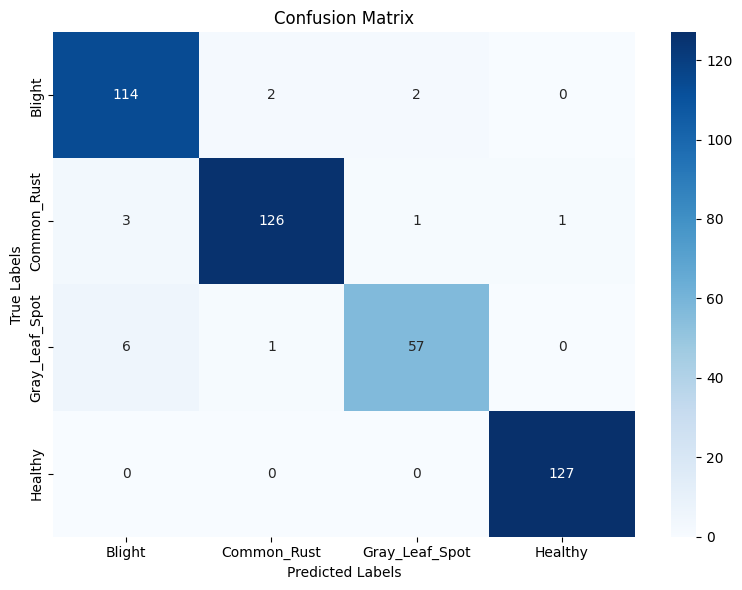

In [28]:
# Function to plot confusion matrix
def plot_confusion_matrix(true_labels, predicted_labels, class_names):
    cm = confusion_matrix(true_labels, predicted_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.tight_layout()
    plt.show()

# Call the function
plot_confusion_matrix(true_labels, predicted_labels, class_names=test_dataset.classes)


In [29]:
# Print the classification report
print(classification_report(true_labels, predicted_labels, target_names=test_dataset.classes))


                precision    recall  f1-score   support

        Blight       0.93      0.97      0.95       118
   Common_Rust       0.98      0.96      0.97       131
Gray_Leaf_Spot       0.95      0.89      0.92        64
       Healthy       0.99      1.00      1.00       127

      accuracy                           0.96       440
     macro avg       0.96      0.95      0.96       440
  weighted avg       0.96      0.96      0.96       440



In [30]:
# Calculate precision, recall, and F1-score
from sklearn.metrics import accuracy_score
cm = confusion_matrix(true_labels, predicted_labels)

# Example for a single class (class 0)
precision = cm[0, 0] / cm[:, 0].sum()  # TP / (TP + FP)
recall = cm[0, 0] / cm[0, :].sum()    # TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)
# Calculate overall accuracy
accuracy = accuracy_score(true_labels, predicted_labels)

print(f"Precision: {precision *100:.2f}% ")
print(f"Recall: {recall*100:.2f}% ")
print(f"F1-Score: {f1_score*100:.2f}% ")
print(f'Accuracy: {accuracy*100:.2f}% ')

Precision: 92.68% 
Recall: 96.61% 
F1-Score: 94.61% 
Accuracy: 96.36% 


### If you wanna load the history from the saved json uncomment below code

In [ ]:
# To load the history from a JSON file
# def load_history_from_json(filename):
#     with open(filename, 'r') as f:
#         history = json.load(f)
#     print(f"History loaded from {filename}")
#     return history

# # Example usage
# history = load_history_from_json(SavedModels_resnet50+"Resnet50_training_historyV3.json")


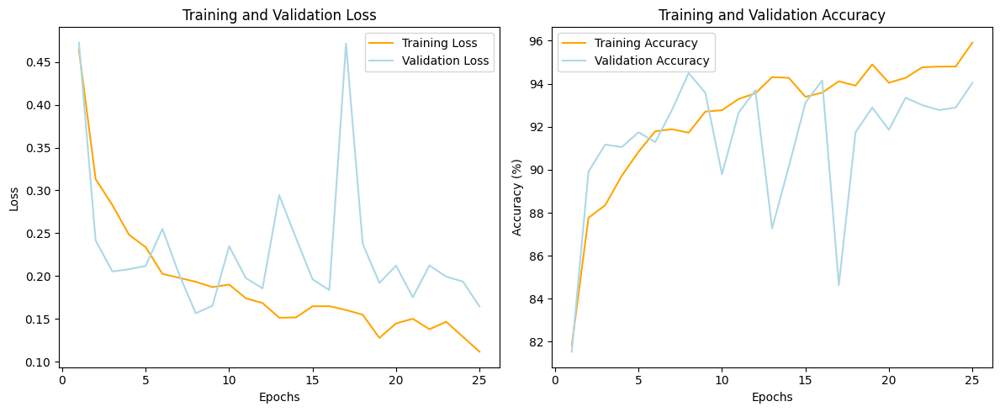

In [31]:
# Plotting Learning Curves
def plot_learning_curves(history):
    epochs = range(1, len(history['train_loss']) + 1)

    # Plot Training and Validation Loss
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history['train_loss'], color='orange', label='Training Loss')
    plt.plot(epochs, history['val_loss'], color='lightblue', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history['train_acc'], color='orange', label='Training Accuracy')
    plt.plot(epochs, history['val_acc'], color='lightblue', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Call the function to plot the learning curves
plot_learning_curves(history)

#  Let improve the score by Hyper Parameter tuning


## Loading the saved model using below code

In [32]:


# # Set device to CPU
# # device = torch.device("cpu")

# Reload the model
NUM_CLASSES = 4
model = models.resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)  # Match the number of classes

# Load the saved weights, mapping to the CPU
# model.load_state_dict(torch.load("SavedModels/resnet50_corn_disease_PRECOPYV2.pth", map_location=device))

# model.load_state_dict(torch.load(SavedModels_resnet50+"/resnet50_corn_disease_PRECOPYV2.pth", map_location=device))
model.load_state_dict(torch.load(SavedModels_resnet50+"/resnet50_corn_disease_PRECOPYV3.pth"))
# Move the model to the CPU
model = model.to(device)

# Set the model to evaluation mode
model.eval()

print("Model successfully loaded on CPU and ready for evaluation.")


Model successfully loaded on CPU and ready for evaluation.


# To find the best hyper parameters uncomment the below code nd run.
## It takes a long time to run so i have commented it
## The best parameters found were  Learning Rate: 0.0001 Batch Size: 16 highest validation accuracy during the tuning process.

In [ ]:
# --My Code here for finding best  hyper parameter

# learning_rates = [0.0001, 0.0005, 0.001, 0.005]
# optimizer = torch.optim.SGD(model.parameters(), lr=LEARNING_RATE, momentum=0.9)
# batch_sizes = [16, 32, 64]
# scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)


# best_val_acc = 0
# best_params = {}

# for lr in [0.0001, 0.001, 0.01]:
#     for batch_size in [16, 32]:
#         # Update DataLoader
#         train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
#         val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

#         # Update Optimizer
#         optimizer = torch.optim.Adam(model.parameters(), lr=lr)

#         # Train Model
#         train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)

#         # Check Validation Accuracy
#         val_acc = history['val_acc'][-1]  # Get last validation accuracy

#         if val_acc > best_val_acc:
#             best_val_acc = val_acc
#             best_params = {'learning_rate': lr, 'batch_size': batch_size}
#             torch.save(model.state_dict(), "best_tuned_model.pth")

# print("Best Parameters:", best_params)
# print("Best Validation Accuracy:", best_val_acc)

## Below is the screenshot as a proof of the output that was generated


![image-2.png](attachment:image-2.png)

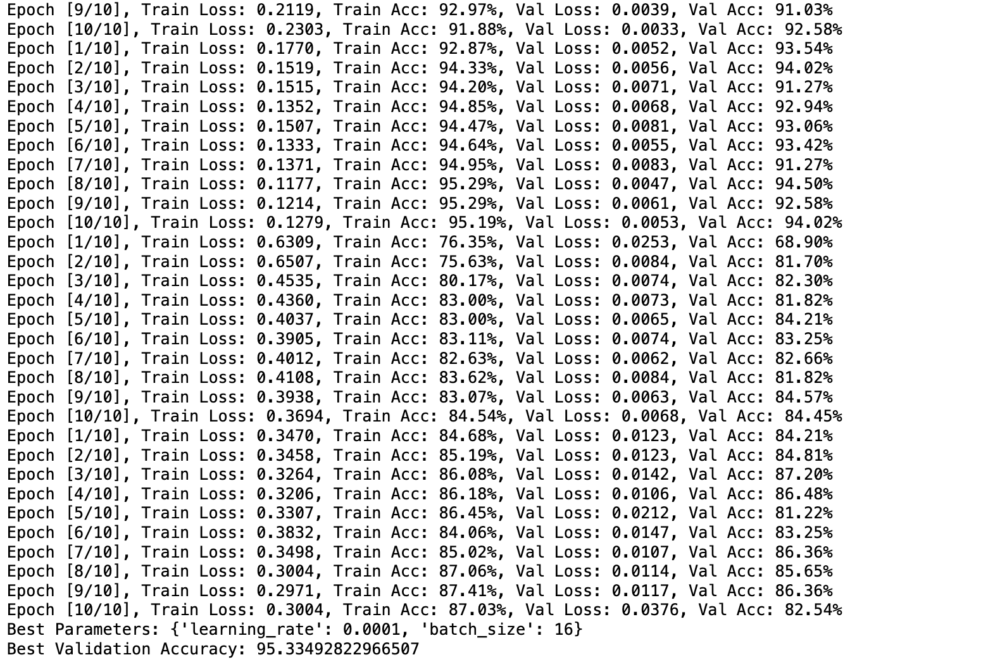

# Hyper Parameter Tuning

In [ ]:
# print("Current Device:", torch.cuda.current_device())
# print("Device Name:", torch.cuda.get_device_name(torch.cuda.current_device()))
torch.cuda.is_available()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [33]:
EPOCHS = 25

In [34]:
# Update DataLoader and Optimizer

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=4)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

# Train Model with Best Hyperparameters
train_model(model, train_loader, val_loader, criterion, optimizer, EPOCHS)

# Save the final model
torch.save(model.state_dict(), SavedModels_resnet50+"/final_best_modelV3.pth")
print("Model retrained and saved with best hyperparameters.")


Epoch [1/25], Train Acc: 95.88%, Val Acc: 94.84%
Epoch [2/25], Train Acc: 96.66%, Val Acc: 94.95%
Epoch [3/25], Train Acc: 97.02%, Val Acc: 95.07%
Epoch [4/25], Train Acc: 97.15%, Val Acc: 95.30%
Epoch [5/25], Train Acc: 97.22%, Val Acc: 95.07%
Epoch [6/25], Train Acc: 97.02%, Val Acc: 94.50%
Epoch [7/25], Train Acc: 97.61%, Val Acc: 94.95%
Epoch [8/25], Train Acc: 97.48%, Val Acc: 95.07%
Epoch [9/25], Train Acc: 98.13%, Val Acc: 94.27%
Epoch [10/25], Train Acc: 98.00%, Val Acc: 94.61%
Epoch [11/25], Train Acc: 98.23%, Val Acc: 94.95%
Epoch [12/25], Train Acc: 97.84%, Val Acc: 94.84%
Epoch [13/25], Train Acc: 98.63%, Val Acc: 95.41%
Epoch [14/25], Train Acc: 98.07%, Val Acc: 94.38%
Epoch [15/25], Train Acc: 98.82%, Val Acc: 95.30%
Epoch [16/25], Train Acc: 98.33%, Val Acc: 94.15%
Epoch [17/25], Train Acc: 98.72%, Val Acc: 94.61%
Epoch [18/25], Train Acc: 98.72%, Val Acc: 94.27%
Epoch [19/25], Train Acc: 99.05%, Val Acc: 94.84%
Epoch [20/25], Train Acc: 98.92%, Val Acc: 95.07%
Epoch [21

## Saving the History after fine tuning

In [35]:
import json

# Save history to a JSON file
def save_history_to_json(history, filename):
    with open(filename, 'w') as f:
        json.dump(history, f)
    print(f"History saved to {filename}")

# Call the function
save_history_to_json(history, SavedModels_resnet50+"/Resnet50_FineTuned_training_historyV3.json")

History saved to /content/drive/MyDrive/SavedModels/RESNET50_Ver4/Resnet50_FineTuned_training_historyV3.json


## Reloading Saved fine. tuned Model

In [36]:
# Loading Model again after saving it to test the code as well as for later use

import torch
import torch.nn as nn
from torchvision import models

# Set device (CPU or GPU)
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define the model architecture
NUM_CLASSES = 4  # Adjust to match the number of classes in your dataset
model = models.resnet50(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, NUM_CLASSES)

# Load the saved weights
model.load_state_dict(torch.load(SavedModels_resnet50+"/final_best_modelV3.pth", map_location=device))

# Move the model to the appropriate device
model = model.to(device)

# Set the model to evaluation mode
model.eval()

print("Best-tuned model successfully loaded and ready for evaluation.")


Best-tuned model successfully loaded and ready for evaluation.


# Evaluation starts for Fine Tuned Model

In [37]:
# Evaluate the model
test_loss, test_acc = evaluate_model(model, test_loader, criterion)
print(f'\nTest Accuracy: {test_acc:.2f}%  Test Loss: {test_loss:.4f}')



Test Accuracy: 96.36%  Test Loss: 0.1746


In [38]:
# call function to compute predictions and true labels
predicted_labels, true_labels = get_predictions_and_labels(model, test_loader)

In [ ]:
# lets plot the confusion matix for Fine tuned Model

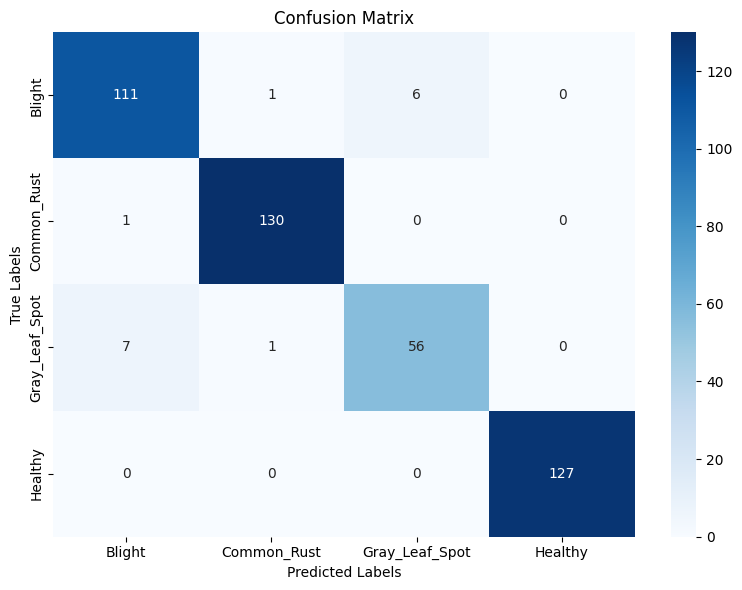

In [39]:
# Call the function
plot_confusion_matrix(true_labels, predicted_labels, class_names=test_dataset.classes)


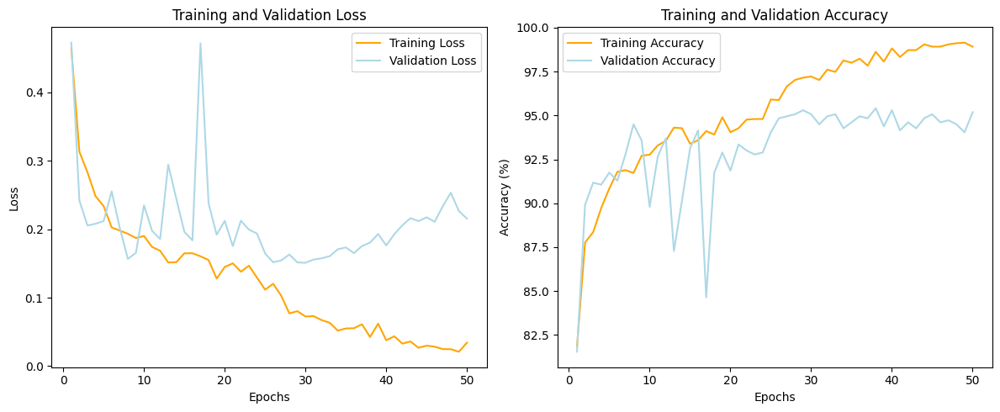

In [40]:
plot_learning_curves(history)

In [41]:
print(classification_report(true_labels, predicted_labels, target_names=test_dataset.classes))


                precision    recall  f1-score   support

        Blight       0.93      0.94      0.94       118
   Common_Rust       0.98      0.99      0.99       131
Gray_Leaf_Spot       0.90      0.88      0.89        64
       Healthy       1.00      1.00      1.00       127

      accuracy                           0.96       440
     macro avg       0.96      0.95      0.95       440
  weighted avg       0.96      0.96      0.96       440



In [42]:
# Calculate precision, recall, and F1-score
from sklearn.metrics import accuracy_score
cm = confusion_matrix(true_labels, predicted_labels)

# Example for a single class (class 0)
precision = cm[0, 0] / cm[:, 0].sum()  # TP / (TP + FP)
recall = cm[0, 0] / cm[0, :].sum()    # TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)
# Calculate overall accuracy
accuracy = accuracy_score(true_labels, predicted_labels)

print(f"Precision: {precision *100:.2f}% ")
print(f"Recall: {recall*100:.2f}% ")
print(f"F1-Score: {f1_score*100:.2f}% ")
print(f'Accuracy: {accuracy*100:.2f}% ')

Precision: 93.28% 
Recall: 94.07% 
F1-Score: 93.67% 
Accuracy: 96.36% 


## 96% is the highest accuracy achieved with the above hyperparameter combination.

In [ ]:
# Loading the history for finetuned model
# history = load_history_from_json(SavedModels_resnet50+"/Resnet50_FineTuned_training_historyV3.json")


History loaded from SavedModels/Resnet50_FineTuned_training_historyV3.json


In [ ]:
# plot_learning_curves(history)

In [43]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 75.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.4-py3-none-any.whl size=39588 sha256=a37df09f65a1876bd2d88277820bced4f9ff9c5c4410238822a0bc212b7649b4
  Stored in directory: /root/.cache/pip/wheels/50/b0/82/1f97b5348c7fe9f0ce0ba18497202cafa5dec4562bd5292680
Successfully built grad-cam


# GradCam ++ Explanantions Starts Here

In [44]:
# Grad-CAM++ inference and visualization
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image

In [45]:

# The tensor_to_image function converts a normalized PyTorch tensor into a
# NumPy image array in the range [0, 1], suitable for visualization.
def tensor_to_image(tensor):

    tensor = tensor.cpu().clone().detach()  # Ensure the tensor is on the CPU
    tensor = tensor.numpy().transpose(1, 2, 0)  # Convert to (H, W, C)
    # Un-normalize using ImageNet mean and std
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    tensor = std * tensor + mean  # Reverse normalization
    tensor = np.clip(tensor, 0, 1)  # Clip values to [0, 1] range
    return tensor

In [46]:
# The below function is for Plotting the Graph for prediction probabilities
# for each class as a bar chart, highlighting the true class in green and the
# predicted class in red if they differ.

def plot_value_array(logit, label, class_names):
    # Convert logits to probabilities
    probabilities = torch.softmax(logit.squeeze(), dim=0).cpu().numpy()
    label = label.item()

    # Plot the probabilities
    plt.bar(range(len(class_names)), probabilities, color="gray")
    plt.xticks(range(len(class_names)), class_names, ha="right", fontsize=12)
    plt.ylabel("Probability")
    plt.xlabel("Class")
    plt.ylim(0, 1)

    # Highlight the true class in green
    plt.bar(label, probabilities[label], color="green")
    # Highlight the predicted class in red if different from true class
    predicted_class = np.argmax(probabilities)
    if predicted_class != label:
        plt.bar(predicted_class, probabilities[predicted_class], color="red")


In [47]:
# Grad-CAM++ inference and visualization with original image, Grad-CAM++ explanation, and graph
def gradcam_inference_with_original(model, test_loader, class_names, num_images=8):
    model.eval()
    images, labels, logits = [], [], []
    with torch.no_grad():
        for image_batch, label_batch in test_loader:
            image_batch, label_batch = image_batch.to(device), label_batch.to(device)
            output = model(image_batch)
            images.extend(image_batch)  # Collect all images
            logits.extend(output)      # Collect logits
            labels.extend(label_batch) # Collect labels

    print("Generating Grad-CAM++ visualizations...")
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]])
                          # , use_cuda=torch.cuda.is_available())
    sampled_indices = random.sample(range(len(images)), num_images)  # Sample random indices

    # Adjust figure size and layout
    plt.figure(figsize=(20, num_images * 6))  # Dynamic height for better spacing
    count = 1
    for idx in sampled_indices:
        img_tensor = images[idx].unsqueeze(0)  # Add batch dimension for Grad-CAM++
        logit = logits[idx].unsqueeze(0)       # Add batch dimension for logits
        lbl = labels[idx]                      # Scalar label

        # Convert tensor to image
        img = tensor_to_image(img_tensor[0])
        grayscale_cam = cam(input_tensor=img_tensor)
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)

        # Display the original image
        plt.subplot(num_images, 3, count)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Original: {class_names[lbl.item()]}", fontsize=20)
        count += 1

        # Display the Grad-CAM++ visualization
        plt.subplot(num_images, 3, count)
        plt.imshow(visualization)
        plt.axis('off')
        plt.title(f"Predicted: {class_names[logit.argmax(1).item()]}", fontsize=20)
        count += 1

        # Display the prediction probabilities
        plt.subplot(num_images, 3, count)
        plot_value_array(logit, lbl, class_names)
        count += 1

    plt.tight_layout()
    plt.show()

# # Example usage
# class_names = test_dataset.classes
# gradcam_inference_with_original(model, test_loader, class_names, num_images=5)


Generating Grad-CAM++ visualizations...


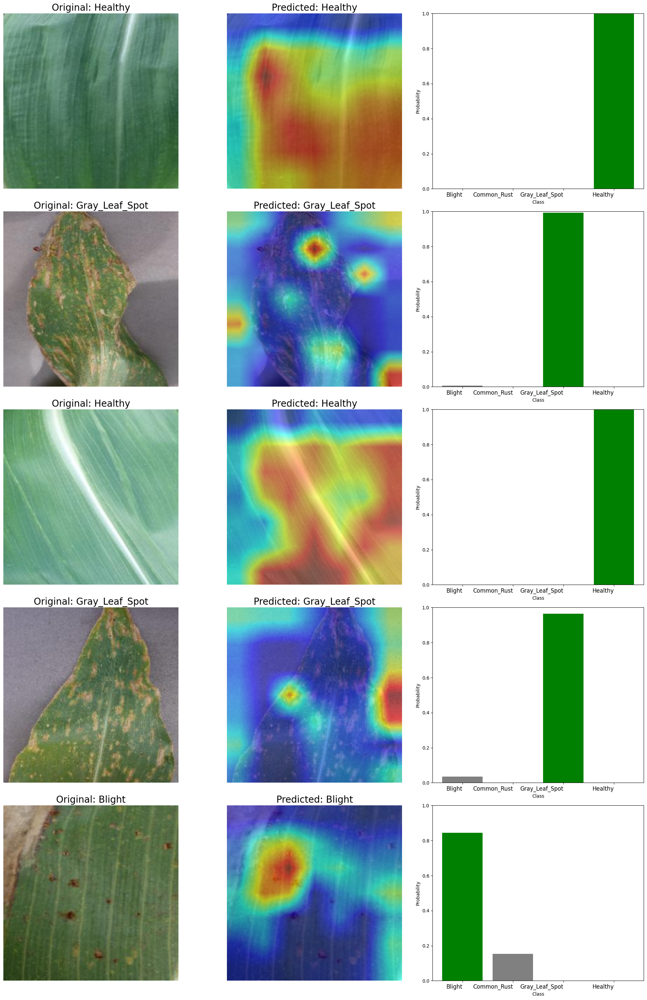

In [48]:
class_names = test_dataset.classes
gradcam_inference_with_original(model, test_loader, class_names, num_images=5)


Generating Grad-CAM++ visualizations...


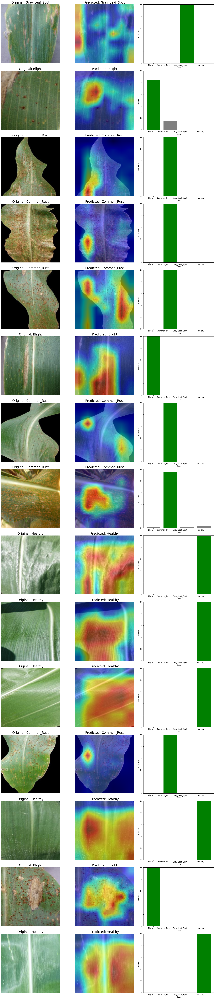

In [49]:
class_names = test_dataset.classes
gradcam_inference_with_original(model, test_loader, class_names, num_images=15)

In [57]:
# Function to preprocess a single image
def preprocess_image(image_path, transform):
    img = Image.open(image_path).convert("RGB")
    return transform(img).unsqueeze(0)  # Add batch dimension


In [76]:

image_paths = [
   Testing_Images+"/Common_Rust/Corn_Common_Rust_1.jpg",
    Testing_Images+"/Healthy/Corn_Health_1.jpg",
    Testing_Images+"/Blight/Corn_Blight_1.JPG",
    Testing_Images+"/Gray_Leaf_Spot/Corn_Gray_Spot_1.JPG"
]


In [51]:
#  Perform Model Inference
# This function performs inference for a single preprocessed image.
def perform_inference(model, img_tensor):
    model.eval()
    with torch.no_grad():
        output = model(img_tensor.to(device))
    return output


In [52]:

# The below function generates a Grad-CAM++ heatmap for a given image
# by focusing on the most relevant regions of the image for the model's predictions,
# using the specified target layer (layer4[-1]) of the model

def generate_gradcam(model, img_tensor):
    cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4[-1]])
                          # , use_cuda=torch.cuda.is_available())
    grayscale_cam = cam(input_tensor=img_tensor)
    return grayscale_cam[0, :]  # Return the first heatmap


In [53]:

# The below function visualizes the results of a model's prediction by displaying the original image,
# the Grad-CAM++ heatmap for the model's focus, and a bar chart showing the predicted probabilities for each class.

def visualize_result(img, visualization, output, class_names, image_name, figsize=(15, 5)):
    # Convert logits to probabilities
    probabilities = torch.softmax(output.squeeze(), dim=0).cpu().numpy()

    # Predicted class
    predicted_label = probabilities.argmax()

    # Create figure with adjustable size
    fig, axes = plt.subplots(1, 3, figsize=figsize)

    # Plot original image
    axes[0].imshow(img)
    axes[0].axis('off')
#     {class_names[lbl.item()]}
    axes[0].set_title(f"Original: {image_name}", fontsize=18)

    # Plot Grad-CAM++ heatmap
    axes[1].imshow(visualization)
    axes[1].axis('off')
    axes[1].set_title(f"Predicted: {class_names[predicted_label]}", fontsize=18)

    # Plot prediction probabilities
    axes[2].bar(range(len(class_names)), probabilities, color="green")
    axes[2].set_xticks(range(len(class_names)))
    axes[2].set_xticklabels(class_names, fontsize=10)
    axes[2].set_ylim(0, 1)
    axes[2].set_xlabel("Class")
    axes[2].set_ylabel("Probability")
    axes[2].set_title("Prediction Probabilities")

    plt.tight_layout()
    plt.show()



In [54]:
def process_and_visualize(model, image_paths, class_names, transform):

    for image_path in image_paths:
        # Preprocess the image
        image_name = image_path.split("/")[-2]  # Extract the file name

        img_tensor = preprocess_image(image_path, transform)
        output = perform_inference(model, img_tensor)

        # Generate Grad-CAM++
        grayscale_cam = generate_gradcam(model, img_tensor)
        img = tensor_to_image(img_tensor[0].cpu())
        visualization = show_cam_on_image(img, grayscale_cam, use_rgb=True)

        # Visualize results
        visualize_result(img, visualization, output, class_names,image_name)


In [55]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


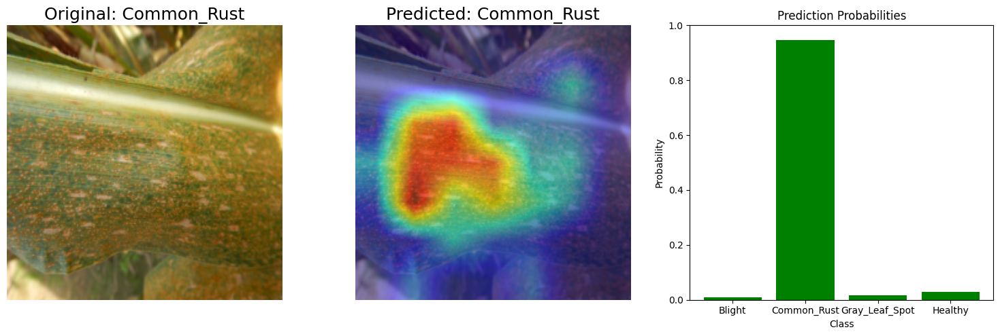

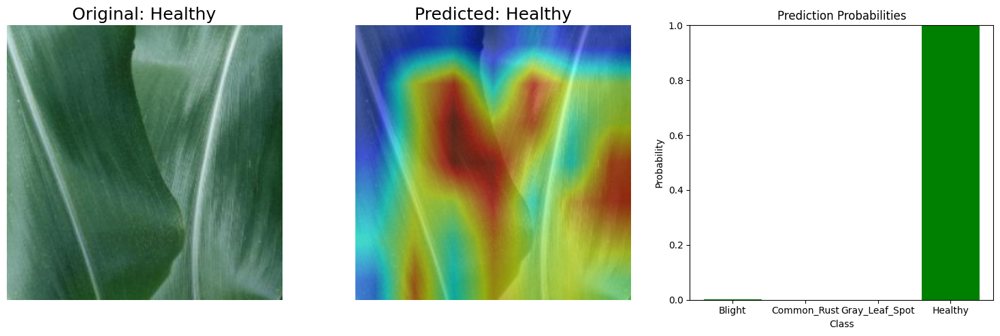

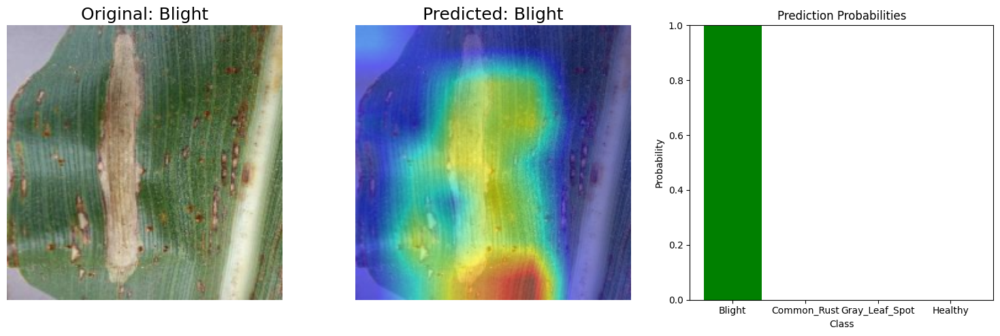

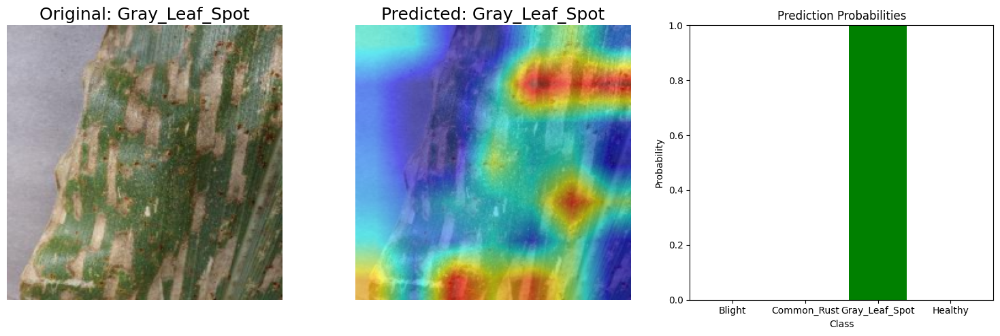

In [62]:
class_names = test_dataset.classes
process_and_visualize(model, image_paths, class_names, transform)

# class_names

In [64]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=ebb4c1887b54a7b05499babe22160789eb84352ce0350c0e84cfaba53f07fd23
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


# Lime Implementation beings here for Resnet50 model

In [65]:

from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries


In [66]:

# Define your preprocessing transform for LIME
def get_preprocess_transform():
    return transforms.Compose([
        transforms.Resize((224, 224)),  # Resize to 224x224
        transforms.ToTensor(),         # Convert to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet stats
                             std=[0.229, 0.224, 0.225]),
    ])

preprocess_transform = get_preprocess_transform()


In [67]:

# Define batch prediction function
def batch_predict(images):
    model.eval()
    images = np.array(images) / 255.0  # Normalize pixel values to [0, 1]
    transformed_images = torch.stack([preprocess_transform(Image.fromarray((img * 255).astype('uint8'))) for img in images])
    transformed_images = transformed_images.to(device)

    with torch.no_grad():
        outputs = model(transformed_images)
        probabilities = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    return probabilities



In [69]:
image_path = data_dir +'/test/Common_Rust/Corn_Common_Rust (31).jpg'

# image_path = Testing_Images+"/Common_Rust/Corn_Common_Rust_1.jpg",
img = Image.open(image_path)
# Function: Preprocess image for LIME
def preprocess_image(img_path, target_size=(224, 224)):
    img = Image.open(img_path).convert("RGB")  # Convert to RGB
    img = img.resize((224, 224))
    return np.array(img.resize(target_size))   # Return resized image as NumPy array


In [ ]:
# Load and preprocess the image

# image_path = 'dataset/Common_Rust/Blight (3).jpg'
# input_img = preprocess_image(image_path)
# # image_path = 'dataset/Blight/Corn_Blight (100).jpg'
# img = Image.open(image_path)

# # Convert to RGB if necessary
# if img.mode != 'RGB':
#     img = img.convert('RGB')

# # Resize the image to model input size
# img = img.resize((224, 224))

# # Convert to array
# input_img = np.array(img)

In [71]:
# Initialize LIME image explainer
input_img = preprocess_image(image_path)
def Lime_explainer1():
    explainer = lime_image.LimeImageExplainer(random_state=42)

    # Get the explanation for the top classes
    explanation = explainer.explain_instance(
        input_img,         # Input image in array format
        batch_predict,     # Prediction function
        top_labels=5,      # Number of top classes to explain
        hide_color=0,      # Background color for hidden regions (0 is black)
        num_samples=1000   # Number of perturbed samples for explanation
    )
    return explanation

explanation = Lime_explainer1()

  0%|          | 0/1000 [00:00<?, ?it/s]

In [72]:
# Print the top 5 predictions with their probabilities
class_names = list(test_dataset.classes)  # Class names from your test dataset
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
top5_idx = probs.argsort()[-5:][::-1]

print("Top 5 predictions:")
for idx in top5_idx:
    print(f"Class {class_names[idx]}: {probs[idx]:.4f}")

Top 5 predictions:
Class Common_Rust: 0.9737
Class Healthy: 0.0132
Class Gray_Leaf_Spot: 0.0075
Class Blight: 0.0057


# Lime Explaination for Single Image

In [73]:
def Lime_Explanation_for_Single_Image():
    # Visualize explanations for the top 5 predicted classes
    plt.figure(figsize=(20, 4 * 5))
    for idx, label in enumerate(explanation.top_labels):
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=5, hide_rest=True
        )

        img_boundary = mark_boundaries(temp / 255.0, mask)

        # Original image
        plt.subplot(5, 2, 2 * idx + 1)
        plt.imshow(img)
        plt.title('Original Image')
        plt.axis('off')

        # LIME explanation
        plt.subplot(5, 2, 2 * idx + 2)
        plt.imshow(img_boundary)
        class_name = class_names[label]  # Map label index to class name
        plt.title(f"LIME Explanation for class: {class_name}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


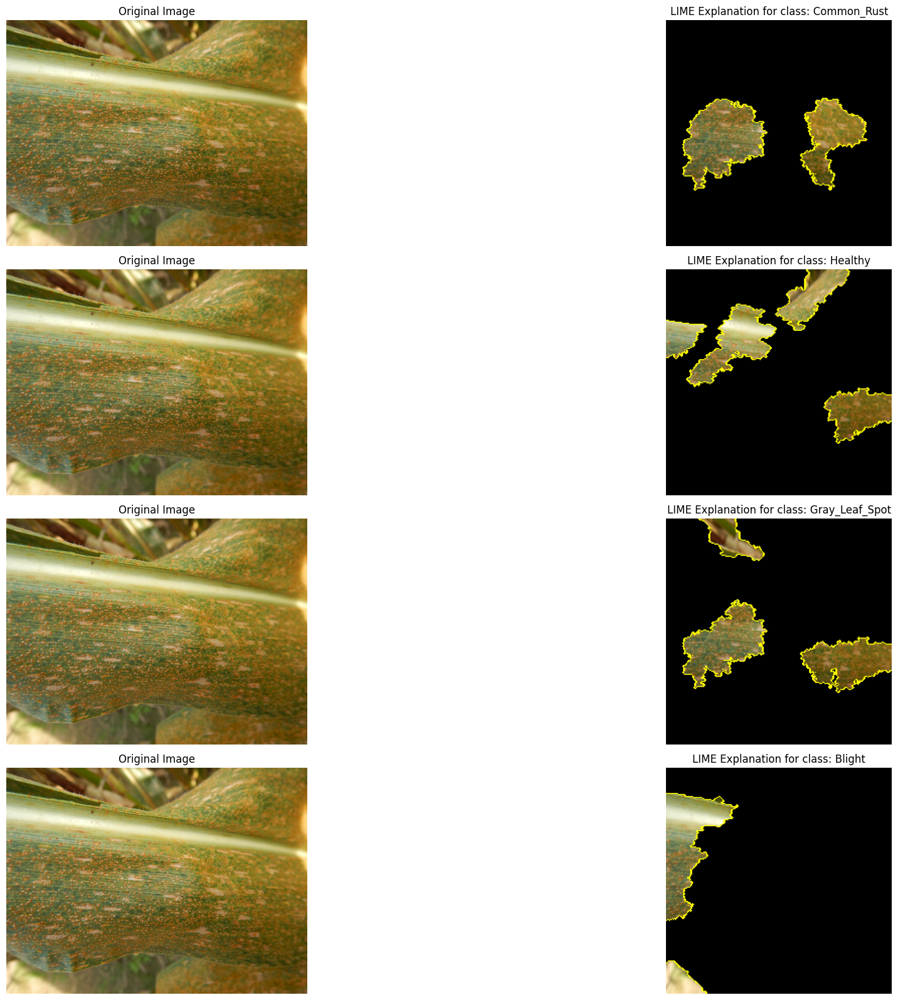

In [74]:
Lime_Explanation_for_Single_Image()

In [ ]:
# def plot_prediction_graph(probs, class_names):
#     plt.bar(class_names, probs, color='green')  # Use bar instead of barh for vertical bars
#     plt.ylabel("Probability")
#     plt.xlabel("Classes")
#     plt.title("Prediction Probabilities")
#     plt.xticks(rotation=45)  # Rotate class labels for better readability
#     plt.ylim(0, 1)  # Set the Y-axis limit to [0, 1]
#     plt.tight_layout()
#     plt.show()

In [78]:

# Function: Visualize LIME explanation
def visualize_lime_explanation(input_img, explanation, top_label, class_name):
    temp, mask = explanation.get_image_and_mask(
        top_label,
        positive_only=True,
        num_features=5,
        hide_rest=False
    )
    return mark_boundaries(temp / 255.0, mask)


# LIME Explnataion for the set of images

In [79]:
# The below function helps us and shows LIME explanations for a set of input images
# including the original image, the image areas that affect the prediction according
# to LIME and prediction probabilities for each class .


def generate_lime_explanations(image_paths, batch_predict_fn, class_names):
    explainer = lime_image.LimeImageExplainer(random_state=42)

    # Create figure with correct size
    num_images = len(image_paths)
    fig, axes = plt.subplots(num_images, 3, figsize=(15, num_images * 5))

    for i, img_path in enumerate(image_paths):
        # Preprocess image
        input_img = preprocess_image(img_path)

        # Generate LIME explanation
        explanation = explainer.explain_instance(
            input_img,
            batch_predict_fn,
            top_labels=len(class_names),
            hide_color=0,
            num_samples=1000
        )


        # Get prediction probabilities and top label
        probs = batch_predict_fn(np.expand_dims(input_img, axis=0))[0]
        top_label = explanation.top_labels[0]

        # Visualize LIME explanation
        img_boundary = visualize_lime_explanation(input_img, explanation, top_label, class_names[top_label])

        # Ensure axes is a 2D array for consistency
        if num_images == 1:
            ax = axes
        else:
            ax = axes[i]

        # Plot Original Image
        ax[0].imshow(input_img / 255.0)
        ax[0].axis('off')
        ax[0].set_title(f"Original: {class_names[top_label]}",fontsize=18)

        # Plot LIME Highlighted Image
        ax[1].imshow(img_boundary)
        ax[1].axis('off')
        ax[1].set_title(f"Predicted LIME: {class_names[top_label]}",fontsize=18)

        # Plot Prediction Graph for All Classes
        ax[2].bar(range(len(class_names)), probs, color='green')
        ax[2].set_xticks(range(len(class_names)))
        ax[2].set_xticklabels(class_names)
        ax[2].set_ylim(0, 1)
        ax[2].set_xlabel("Classes")
        ax[2].set_ylabel("Probability")
        ax[2].set_title("Prediction Probabilities",fontsize=18)

    plt.tight_layout()
    plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

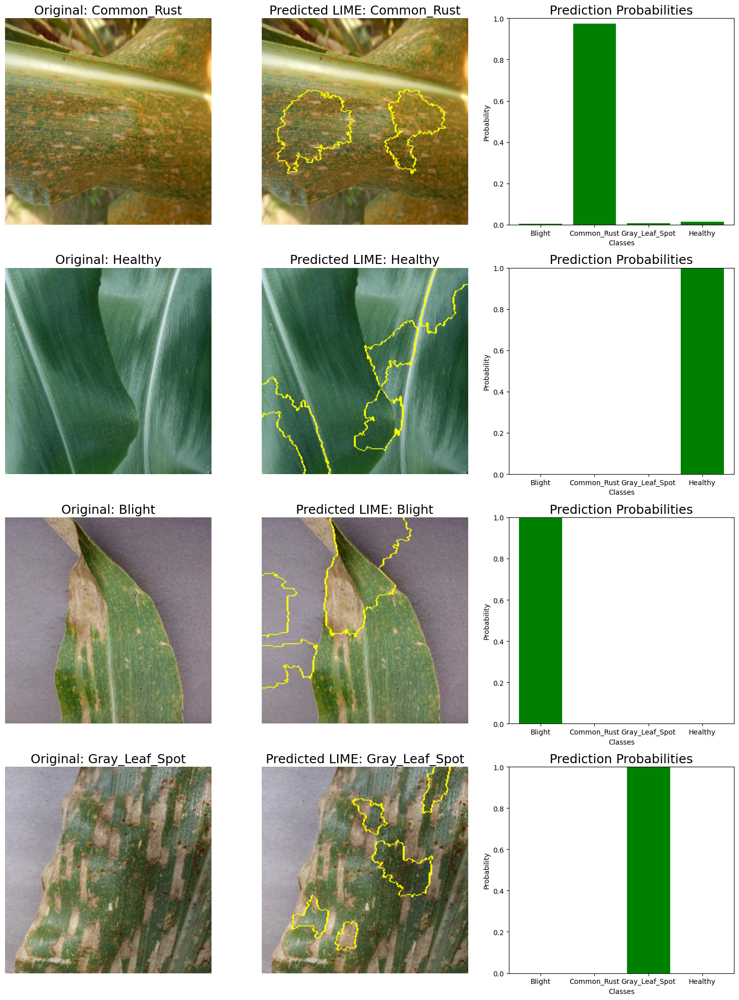

In [85]:

# Example usage

image_paths = [
   Testing_Images+"/Common_Rust/Corn_Common_Rust_1.jpg",
    Testing_Images+"/Healthy/Corn_Health_1.jpg",
    Testing_Images+"/Blight/Corn_Blight_4.JPG",
    Testing_Images+"/Gray_Leaf_Spot/Corn_Gray_Spot_1.JPG"
]

class_names = test_dataset.classes  # List of class names
generate_lime_explanations(image_paths, batch_predict, class_names)


In [ ]:
#

# Plotting The Contributing Pixels

In [ ]:
# My below function will generate and visualize LIME explanations for a set of images
# It will ve highlighting the most influential pixels contributing to the model's predictions

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

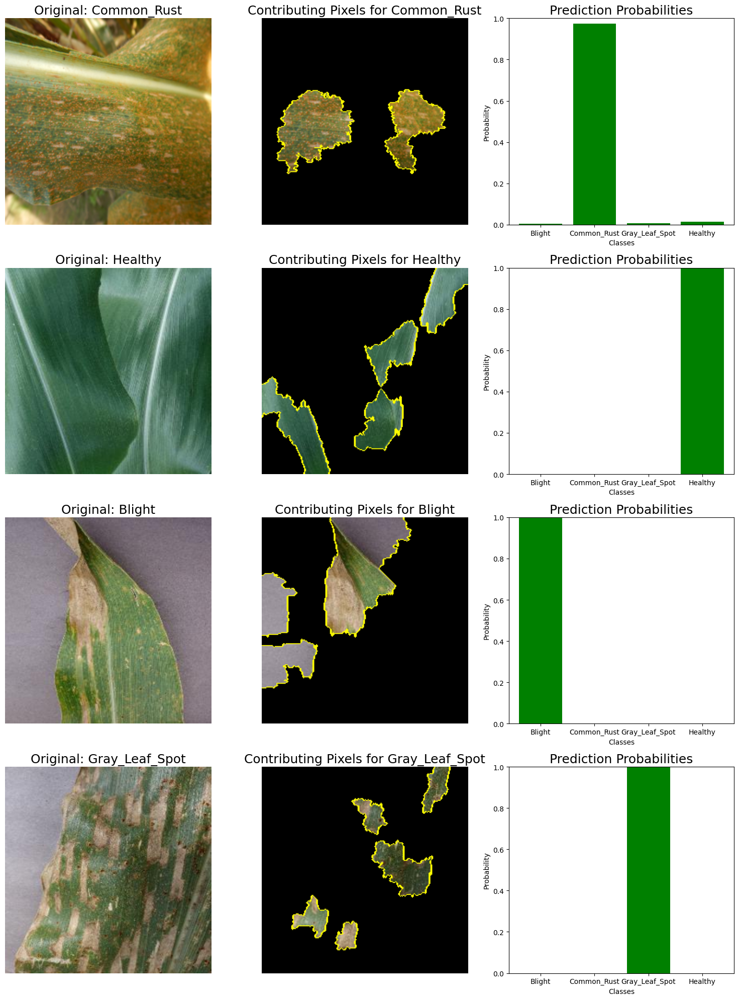

In [86]:
def visualize_contributing_pixels(image_paths, batch_predict_fn, class_names):
    explainer = lime_image.LimeImageExplainer(random_state=42)

    # Adjust figure size dynamically for consistent layout
    num_images = len(image_paths)
    fig, axes = plt.subplots(num_images, 3, figsize=(15, num_images * 5))

    for i, img_path in enumerate(image_paths):
        # Preprocess image
        input_img = preprocess_image(img_path)

        # Generate LIME explanation
        explanation = explainer.explain_instance(
            input_img,
            batch_predict_fn,
            top_labels=len(class_names),
            hide_color=0,
            num_samples=1000
        )

        # Get prediction probabilities and top label
        probs = batch_predict_fn(np.expand_dims(input_img, axis=0))[0]
        top_label = explanation.top_labels[0]

        # Highlight contributing pixels
        temp, mask = explanation.get_image_and_mask(
            top_label,
            positive_only=True,  # Show only positively contributing regions
            num_features=5,      # Number of important superpixels
            hide_rest=True        # Hide non-contributing regions
        )
        contributing_pixels = mark_boundaries(temp / 255.0, mask)

        # Ensure axes is a 2D array for consistency
        if num_images == 1:
            ax = axes
        else:
            ax = axes[i]

        # Plot Original Image
        ax[0].imshow(input_img / 255.0)
        ax[0].axis('off')
        ax[0].set_title(f"Original: {class_names[top_label]}",fontsize=18)

        # Plot Contributing Pixels
        ax[1].imshow(contributing_pixels)
        ax[1].axis('off')
        ax[1].set_title(f"Contributing Pixels for {class_names[top_label]}",fontsize=18)

        # Plot Prediction Graph
        ax[2].bar(range(len(class_names)), probs, color="green")
        ax[2].set_xticks(range(len(class_names)))
        ax[2].set_xticklabels(class_names)
        ax[2].set_ylim(0, 1)
        ax[2].set_xlabel("Classes")
        ax[2].set_ylabel("Probability")
        ax[2].set_title("Prediction Probabilities",fontsize=18)

    plt.tight_layout()
    plt.show()


# Example Usage
class_names = test_dataset.classes  # List of class names
visualize_contributing_pixels(image_paths, batch_predict, class_names)
